# Necessary Improrts

In [1]:
!pip install -U -q segmentation-models
!pip install -q tensorflow==2.2.1
!pip install -q keras==2.5

import os
os.environ["SM_FRAMEWORK"] = "tf.keras"
import tensorflow
from tensorflow import keras
import segmentation_models as sm

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.7/50.7 kB 3.5 MB/s eta 0:00:00
ERROR: Could not find a version that satisfies the requirement tensorflow==2.2.1 (from versions: 2.8.0rc0, 2.8.0rc1, 2.8.0, 2.8.1, 2.8.2, 2.8.3, 2.8.4, 2.9.0rc0, 2.9.0rc1, 2.9.0rc2, 2.9.0, 2.9.1, 2.9.2, 2.9.3, 2.10.0rc0, 2.10.0rc1, 2.10.0rc2, 2.10.0rc3, 2.10.0, 2.10.1, 2.11.0rc0, 2.11.0rc1, 2.11.0rc2, 2.11.0, 2.11.1, 2.12.0rc0, 2.12.0rc1, 2.12.0, 2.12.1, 2.13.0rc0, 2.13.0rc1, 2.13.0rc2, 2.13.0, 2.14.0rc0, 2.14.0rc1)
ERROR: No matching distribution found for tensorflow==2.2.1
ERROR: Could not find a version that satisfies the requirement keras==2.5 (from versions: 0.2.0, 0.3.0, 0.3.1, 0.3.2, 0.3.3, 1.0.0, 1.0.1, 1.0.2, 1.0.3, 1.0.4, 1.0.5, 1.0.6, 1.0.7, 1.0.8, 1.1.0, 1.1.1, 1.1.2, 1.2.0, 1.2.1, 1.2.2, 2.0.0, 2.0.1, 2.0.2, 2.0.3, 2.0.4, 2.0.5, 2.0.6, 2.0.7, 2.0.8, 2.0.9, 2.1.0, 2.1.1, 2.1.2, 2.1.3, 2.1.4, 2.1.5, 2.1.6, 2.2.0, 2.2.1, 2.2.2, 2.2.3, 2.2.4, 2.2.5, 2.3.0, 2.3.1, 2.4.0, 2.4.1, 2.4.2, 2.4.3, 2.5.0rc

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
import os
import glob
from PIL import Image
from numpy import moveaxis

import torch
import albumentations as A
import random


from torch.utils.data import DataLoader
from skimage.io import imread, imshow
from sklearn.model_selection import train_test_split
from keras.models import Model
from keras.layers import Input, Conv2D, MaxPooling2D, concatenate, Conv2DTranspose,Dropout
import tensorflow as tf

# Data Loading

Before we begin loading the data we must look at how the directory of the data is structured!

Inside the trainset folder we have 2 folders
<ol>
    <li>train-labels</li>
    <li>train-volume</li>
</ol>

<img src="Images/trainset.png" alt="trainset" width="20%"/>

1. Inside the train-labels - we have all the annotated tif images

<img src="Images/label.png" alt="label" width=20%/>
   
2. Inside the train-volumes - we have all the true tif images
   
<img src="Images/volume.png" alt="volume" width=20%/>

So, our data is sorted like this

1. train-labels
   1. 30 labeled tif images
<br>
2. train-volumes
   1. 30 tif images

In [ ]:
data = glob.glob('trainset/train-volume/*.tif')
label = glob.glob('trainset/train-labels/*.tif')

In [ ]:
def fun(str):
    '''
    we define a function fun because when we want the data inside the two lists data and label to be in the right ascending order to avoid any future confusion.

    Parameters
    ------------
    str : String path to the image

    Return
    ---------
    int : number which identifies the image

    '''
    a = list(str.split('_'))#basically we split the above data based on "_" so we get something like this     a = ['./trainset/train-volume/train-volume' , '0.tif']
    b = a[-1].split('.')#then we split a[-1](i.e. 0.tif) now again based on "." so we get    b = ['0' , 'tif']
    return int(b[0])#we return the integer 0


In [ ]:
data.sort(key = fun )#sort accoring to the above function
label.sort(key = fun)

In [ ]:
data

['trainset/train-volume/train-volume_0.tif',
 'trainset/train-volume/train-volume_1.tif',
 'trainset/train-volume/train-volume_2.tif',
 'trainset/train-volume/train-volume_3.tif',
 'trainset/train-volume/train-volume_4.tif',
 'trainset/train-volume/train-volume_5.tif',
 'trainset/train-volume/train-volume_6.tif',
 'trainset/train-volume/train-volume_7.tif',
 'trainset/train-volume/train-volume_8.tif',
 'trainset/train-volume/train-volume_9.tif',
 'trainset/train-volume/train-volume_10.tif',
 'trainset/train-volume/train-volume_11.tif',
 'trainset/train-volume/train-volume_12.tif',
 'trainset/train-volume/train-volume_13.tif',
 'trainset/train-volume/train-volume_14.tif',
 'trainset/train-volume/train-volume_15.tif',
 'trainset/train-volume/train-volume_16.tif',
 'trainset/train-volume/train-volume_17.tif',
 'trainset/train-volume/train-volume_18.tif',
 'trainset/train-volume/train-volume_19.tif',
 'trainset/train-volume/train-volume_20.tif',
 'trainset/train-volume/train-volume_21.tif'

In [ ]:
label

['trainset/train-labels/train-labels_0.tif',
 'trainset/train-labels/train-labels_1.tif',
 'trainset/train-labels/train-labels_2.tif',
 'trainset/train-labels/train-labels_3.tif',
 'trainset/train-labels/train-labels_4.tif',
 'trainset/train-labels/train-labels_5.tif',
 'trainset/train-labels/train-labels_6.tif',
 'trainset/train-labels/train-labels_7.tif',
 'trainset/train-labels/train-labels_8.tif',
 'trainset/train-labels/train-labels_9.tif',
 'trainset/train-labels/train-labels_10.tif',
 'trainset/train-labels/train-labels_11.tif',
 'trainset/train-labels/train-labels_12.tif',
 'trainset/train-labels/train-labels_13.tif',
 'trainset/train-labels/train-labels_14.tif',
 'trainset/train-labels/train-labels_15.tif',
 'trainset/train-labels/train-labels_16.tif',
 'trainset/train-labels/train-labels_17.tif',
 'trainset/train-labels/train-labels_18.tif',
 'trainset/train-labels/train-labels_19.tif',
 'trainset/train-labels/train-labels_20.tif',
 'trainset/train-labels/train-labels_21.tif'

### Lets Visualie some of the images and corresonding labels

In [ ]:
#https://www.blog.pythonlibrary.org/2021/06/23/creating-an-animated-gif-with-python/
def make_gif():
    frames = [Image.open(image) for image in label]
    frame_one = frames[0]
    frame_one.save("cells_label.gif", format="GIF", append_images=frames,
               save_all=True, duration=500, loop=0)
make_gif()

<img src="./cells.gif" alt="gif of cells" width=35%/>
<img src="./cells_label.gif" alt="gif of labels" width=35%/>

https://www.blog.pythonlibrary.org/2021/06/23/creating-an-animated-gif-with-python/ (I used this website and made the above animations)


#### Now lets look at a few images specifically

In [ ]:
def read(path , bin=False , z = None):#reads an image and outputs the corresponding read data
    if bin:
        img = plt.imread(path)
        img = img.reshape(512,512,-1)

        img= np.maximum(z,img)
        img = img*1


    else:
        img = plt.imread(path)#data = moveaxis(img, -1, 0)
        img = img.reshape(512,512,-1)
        img = img
    return img
img = np.zeros((len(data) , 512 , 512 , 1),dtype = np.uint8)
mask = np.zeros((len(label) , 512 , 512 , 1),dtype = np.uint8)
for i in range(len(data)): #iterates over all the images and add the read images to a list called img
    img[i] = read(data[i])
for j in range(len(label)):  #iterates over all the images and add the read images to a list called lab
    z = np.zeros(( 512 , 512 , 1),dtype = np.uint8)
    mask[j] = (read(label[j],True , z) )


/Users/aayush/speed/env/lib/python3.11/site-packages/skimage/io/_plugins/matplotlib_plugin.py:162: UserWarning: The figure layout has changed to tight
  ax.get_figure().tight_layout()


Text(0.5, 1.0, 'label of image 21')

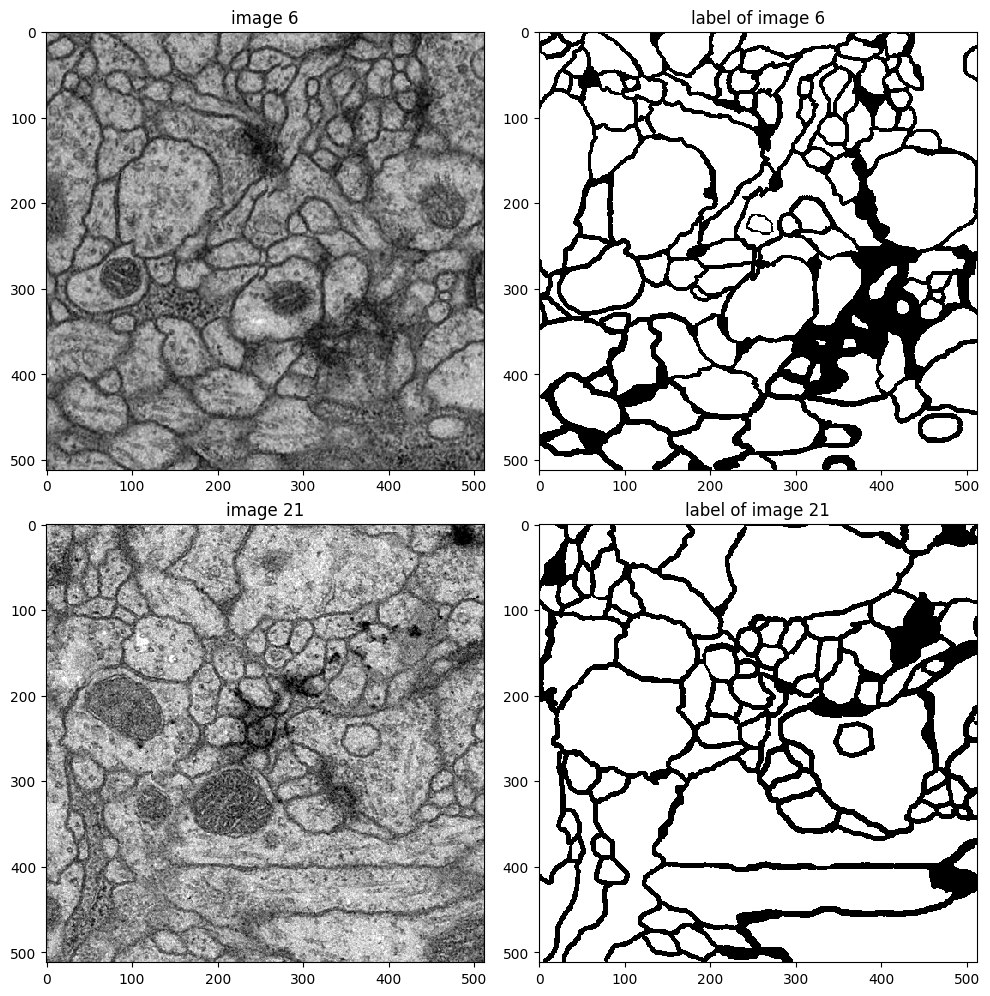

In [ ]:
fig = plt.figure(figsize=((10, 10)))
fig.add_subplot(2, 2, 1)
imshow(img[5])
plt.title("image 6")
fig.add_subplot(2, 2, 2)
imshow(mask[5])
plt.title("label of image 6")
fig.add_subplot(2, 2, 3)
imshow(img[20])
plt.title("image 21")
fig.add_subplot(2, 2, 4)
imshow(mask[20])
plt.title("label of image 21")


# Data Augmentation

Data Augmentation is done to increase the size of the corresponding dataset when the data is not suffecient enough to get good accuracy from a model. There are several data augmentation techniques and for this task I went through the Albumentations documentation and have picked the most relavent ones.

P.S I also tried a several other and was not satisfied with the result so I have included only those which were relevent with their explanation

------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
<br>

Before I go ahead in depth of what techniques and libraries I used, I think it would be unfair if I did not explain why I chose Albumentations over torchvision.

Unfortunately I wasnt able to look over all elements of how to integrate mask and images in the same iteration of augmentation . I tried using several solutions online only to find them not working for custom data or involving complex classes defined for them. Due to which I decided to use Albumentations as it provides much more functionalities and flexibility than torchvision.

In [ ]:
def visualize(image, mask, original_image, original_mask):
    '''
    Visualize the difference between original and augmentated image

    Parameters
    ------------
    image : The new augmentated image
    mask : The corresponding mask
    original_image : The original Image that has been transformed
    original_mask : The mask of original Image that has been transformed

    Return
    ---------
    None

    '''
    fontsize = 18
    fig = plt.figure(figsize=((10, 10)))

    fig.add_subplot(2, 2, 1)

    imshow(original_image)
    plt.title('Original image', fontsize=fontsize)

    fig.add_subplot(2, 2, 2)
    imshow(original_mask)
    plt.title('Original mask', fontsize=fontsize)

    fig.add_subplot(2, 2, 3)

    imshow(image)
    plt.title('Transformed image', fontsize=fontsize)

    fig.add_subplot(2, 2, 4)
    imshow(mask)
    plt.title('Transformed mask', fontsize=fontsize)

## Individual Augmentations

We will look at individual augmentations followed by an example and explanation

All the augmentaiton techniques can be found on this page of the documentation : https://albumentations.ai/docs/api_reference/full_reference/

### Crop Related transformations

Documentation and Source code for all crop related transformation are given below

Documentation : https://albumentations.ai/docs/api_reference/augmentations/crops/transforms/#crop-transforms-augmentationscropstransforms

Github Repo : https://github.com/albumentations-team/albumentations/blob/master/albumentations/augmentations/crops/transforms.py#L329

#### Random Resized Crop

Basically just take the image and crop any random part of it and then rescale to the original size. The default way to interpolate data in Random Resized Crop is using bilinear interpolation.

To understand bilinear interpolation we need to understand linear interpolation. In linear interpolation we basically take the two nearest known point in the x axis and treat them like two point on an x y plane resulting in the equation of line, thus giving us the unknown point from the equation of line.

<img src="Images/Linear_Inter.png" alt="trainsert" width=25%/>

So basically, from the two know points we can get all the points belonging to the line that connect and extend the two points. Thus , as we know the distance of the unknow pixel from the know two pixel we just need to find 'y' (i.e. the pixel value of unknow pixel)

Problem : only considers the two nearest pixels on one axis. Therefore, not the most accurate result .

As this is a biomedical segmentation task which is information and context intensive, lossing information is not a good option. Therefore, we choose bilinear interpolation

Bilinear Interpolation is similar to linear interpolation, but it involves both the x and y axes. We do linear interpolation 3 times for 4 of the nearest pixels on the x and y axes.

<img src="Images/Bilinear.png" alt="trainsert" width=25%/>

We do linear Interpolation between Q12 and Q22 to get R2 , then do linear interpolation between Q11 and Q21 to get R1. Finally to get the point P we do one last linear interpolation between R1 and R2.

Advantage : Loss of information is way less as 4 pixels are considered.

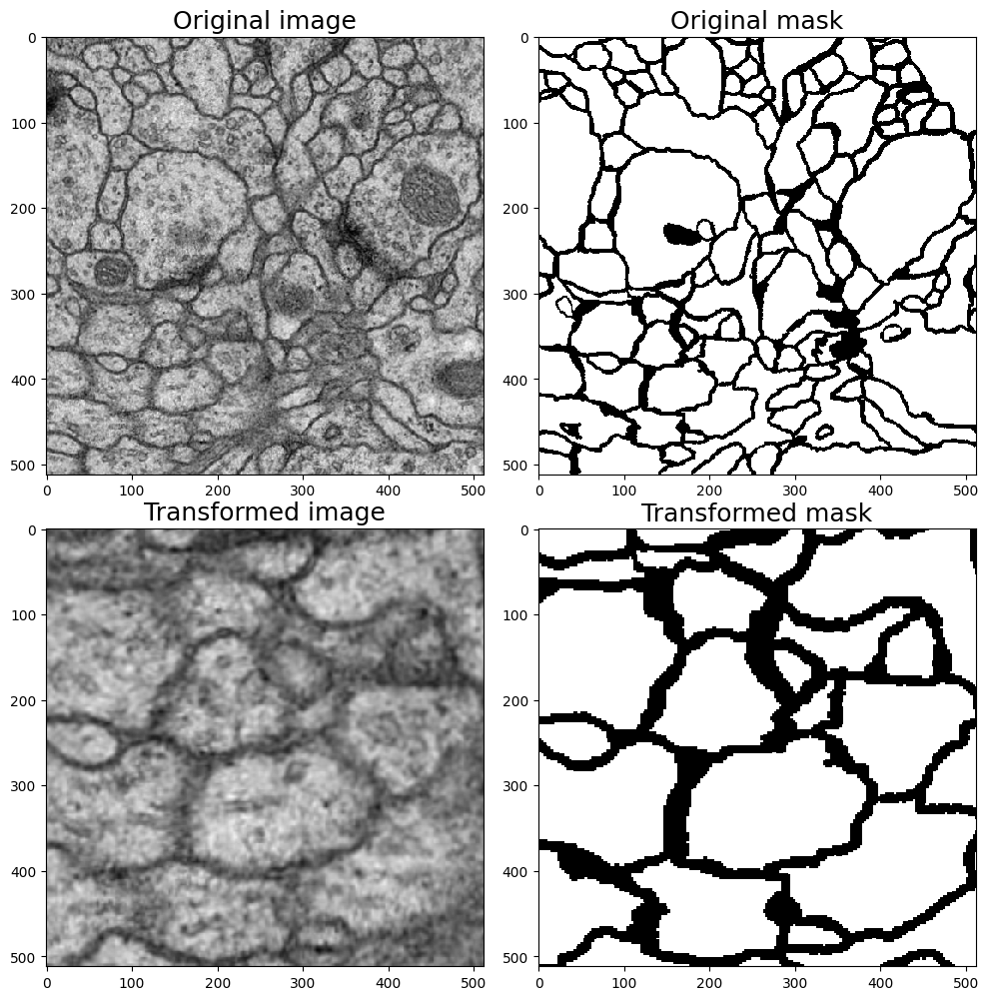

In [ ]:
transform = A.RandomResizedCrop(512,512)
augmented = transform(image=img[0] , mask= mask[0] )
image_padded = augmented['image']
mask_padded = augmented['mask']
visualize(image_padded, mask_padded, original_image=img[0], original_mask=mask[0])

## Non destructive transformations

These are those transformations that result in no loss of information.

### Horizontal Flip

Flips the image Horizontally, i.e. creates a mirror image along the y axis.

There a parameter 'p' which I will talk about later when I compose multiple augmnetation techniques into one.

Documentation : https://albumentations.ai/docs/api_reference/full_reference/#albumentations.augmentations.geometric.transforms.HorizontalFlip

github : https://github.com/albumentations-team/albumentations/blob/master/albumentations/augmentations/geometric/transforms.py#L1226

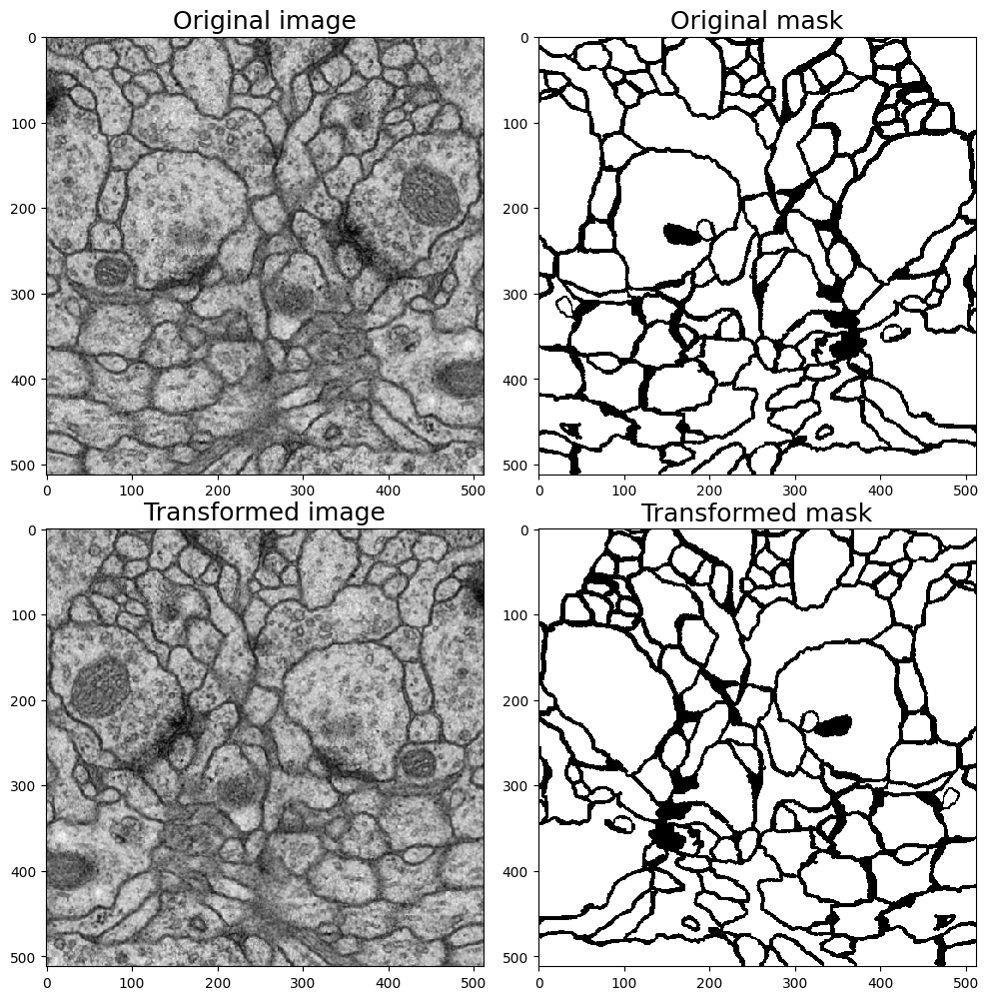

In [ ]:
transform = A.HorizontalFlip(p=1)
augmented = transform(image=img[0], mask=mask[0])
image_padded = augmented['image']
mask_padded = augmented['mask']
visualize(image_padded, mask_padded, original_image=img[0], original_mask=mask[0])

### Vertical Flip

Flips the image Vertically, i.e. creates a mirror image along the x axis.

Documentation : https://albumentations.ai/docs/api_reference/full_reference/#albumentations.augmentations.geometric.transforms.VerticalFlip

github : https://github.com/albumentations-team/albumentations/blob/master/albumentations/augmentations/geometric/transforms.py#L1226

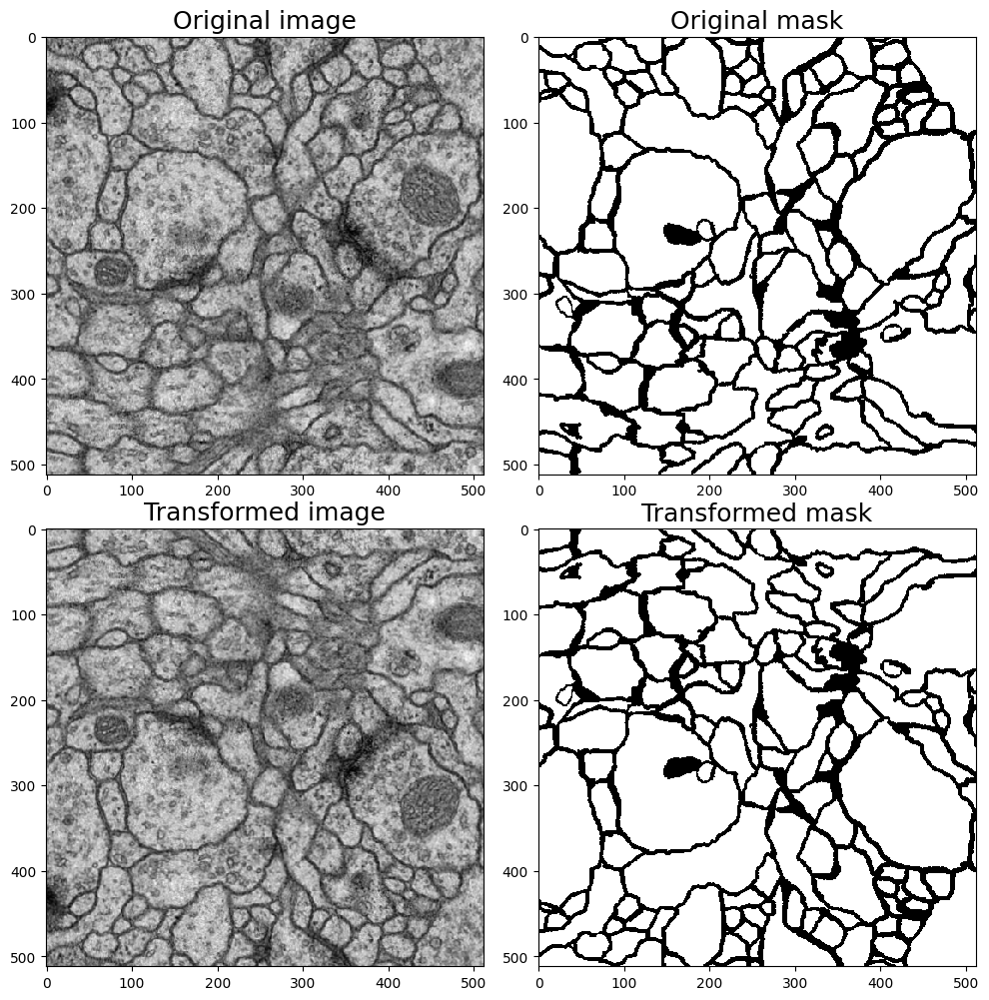

In [ ]:
transform = A.VerticalFlip(p=1)
augmented = transform(image=img[0], mask=mask[0])
image_padded = augmented['image']
mask_padded = augmented['mask']
visualize(image_padded, mask_padded, original_image=img[0], original_mask=mask[0])

### RandomRotate90

Rotate the image by 90 degree(or more) in a random direction.

Documentation : https://albumentations.ai/docs/api_reference/full_reference/#albumentations.augmentations.geometric.rotate.RandomRotate90

github : https://github.com/albumentations-team/albumentations/blob/master/albumentations/augmentations/geometric/transforms.py#L1226

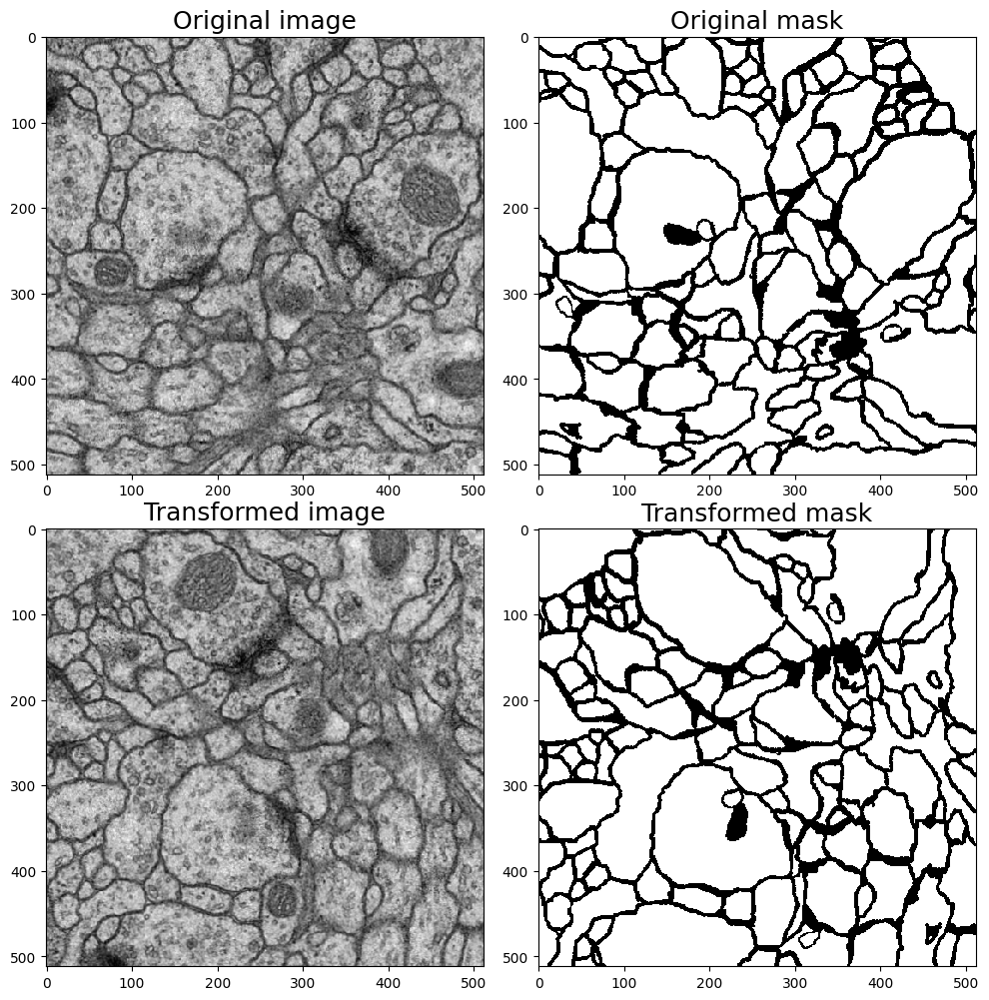

In [ ]:
transform = A.RandomRotate90(p=1)
augmented = transform(image=img[0], mask=mask[0])
image_padded = augmented['image']
mask_padded = augmented['mask']
visualize(image_padded, mask_padded, original_image=img[0], original_mask=mask[0])

### Transpose

swap the row with column.

Documentation : https://albumentations.ai/docs/api_reference/full_reference/#albumentations.augmentations.geometric.transforms.Transpose

github : https://github.com/albumentations-team/albumentations/blob/master/albumentations/augmentations/geometric/transforms.py#L1226

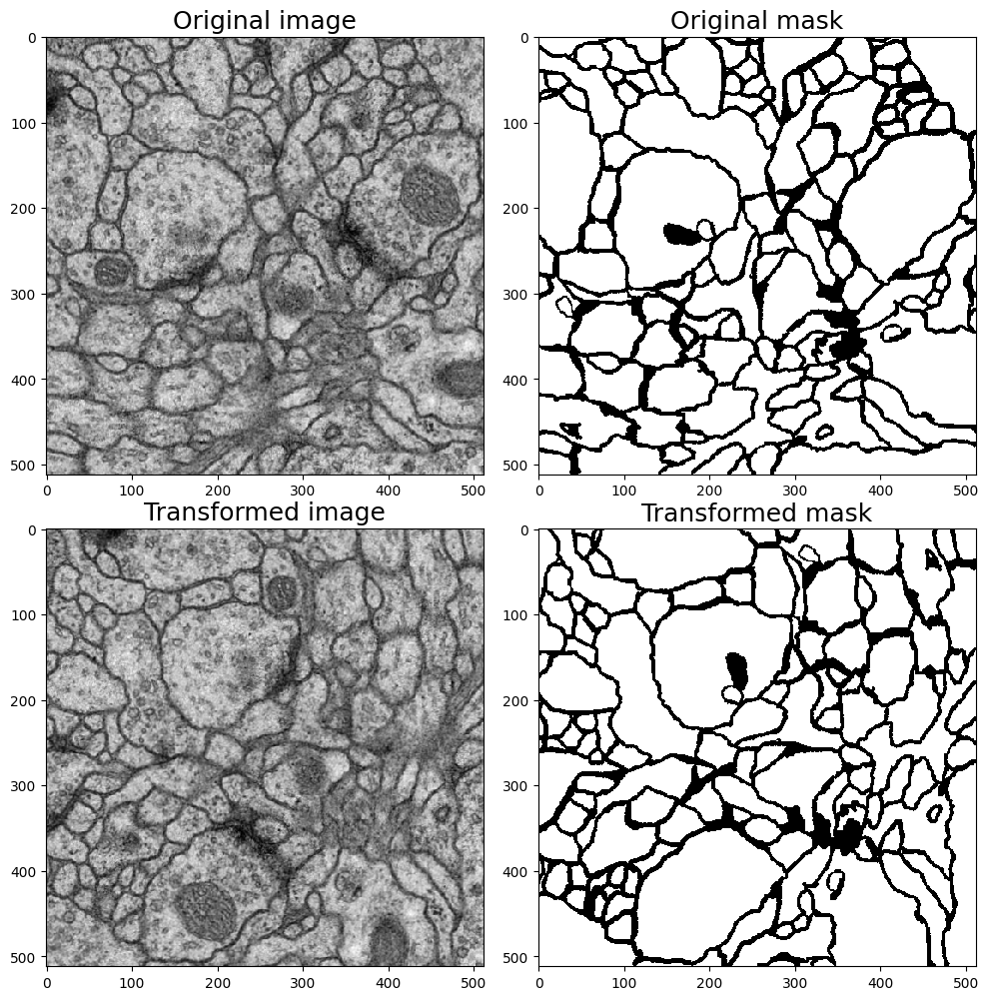

In [ ]:
transform = A.Transpose(p=1)
augmented = transform(image=img[0], mask=mask[0])
image_padded = augmented['image']
mask_padded = augmented['mask']
visualize(image_padded, mask_padded, original_image=img[0], original_mask=mask[0])

## Non-rigid transformations

These distort the image.

### Elastic Transformation

To understand how exactly elastic transformation works we first need to learn what linear transformation is. In a nutshell, linear transformation(in contesxt of data augmentation) is displacement of each pixel to a new location but with 2 restrictions . one , vectors parallel to each other still remain parallel to each other, two , The origin remain at the same position. examples could be rotation , scale etc.

This video from 3blue11brown explain linear transformation really well : https://www.youtube.com/watch?v=kYB8IZa5AuE

Now thats clear, affine transformation is to be understood. Affine transformations basically follow only the parallel rule of linear transformations. Thus, the origin can shift in affine transformation. Therefore we can say all linear transformations are affine transformations but not all affine transformations are linear transformations.

In elastic deformation first a scaled linear transformation is applied. alpha is the value that represents scale (usually a range is specified for the offset value from with random displacemnt is taken.). After which a convolution with a gaussian filter takes place where the standard deviation is sigma.

A lot of my understanding of the above has come from reading the paper mentioned below by Simard et. al.

https://cognitivemedium.com/assets/rmnist/Simard.pdf

Given alpha and sigma, it will generate displacement vectors for all pixels based on random offsets. Alpha controls the strength and sigma controls the smoothness of the displacements.

Documentation : https://albumentations.ai/docs/api_reference/full_reference/#albumentations.augmentations.geometric.transforms.ElasticTransform

github : https://github.com/albumentations-team/albumentations/blob/master/albumentations/augmentations/geometric/transforms.py#L1226

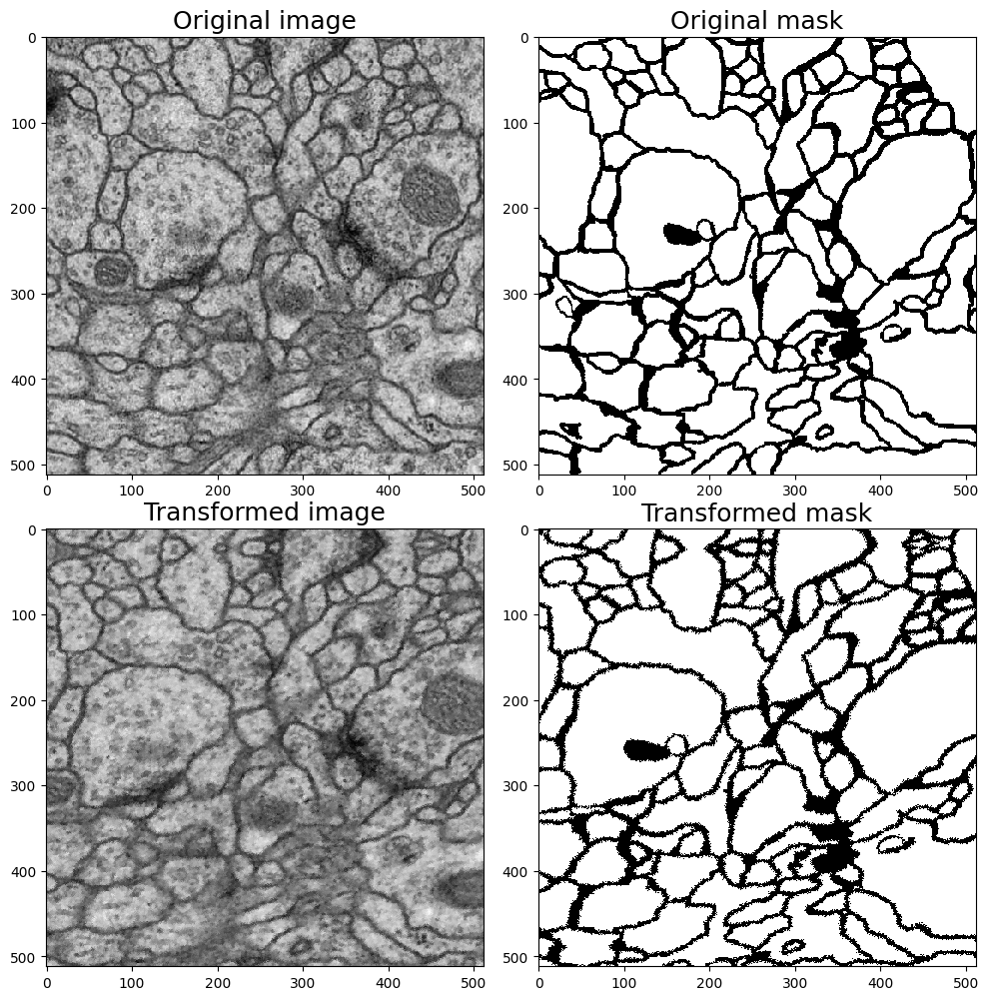

In [ ]:
transform = A.ElasticTransform(alpha = 1 , sigma = 0 , p=1)
augmented = transform(image=img[0], mask=mask[0])
image_padded = augmented['image']
mask_padded = augmented['mask']
visualize(image_padded, mask_padded, original_image=img[0], original_mask=mask[0])

### ShiftScaleRotate

Applies random affine transformations : translate, scale and rotate the input

Documentation : https://albumentations.ai/docs/api_reference/full_reference/?query=qwertyuiop%5B%5D%5CASDFGHJKL%3B%27#albumentations.augmentations.geometric.transforms.ShiftScaleRotate

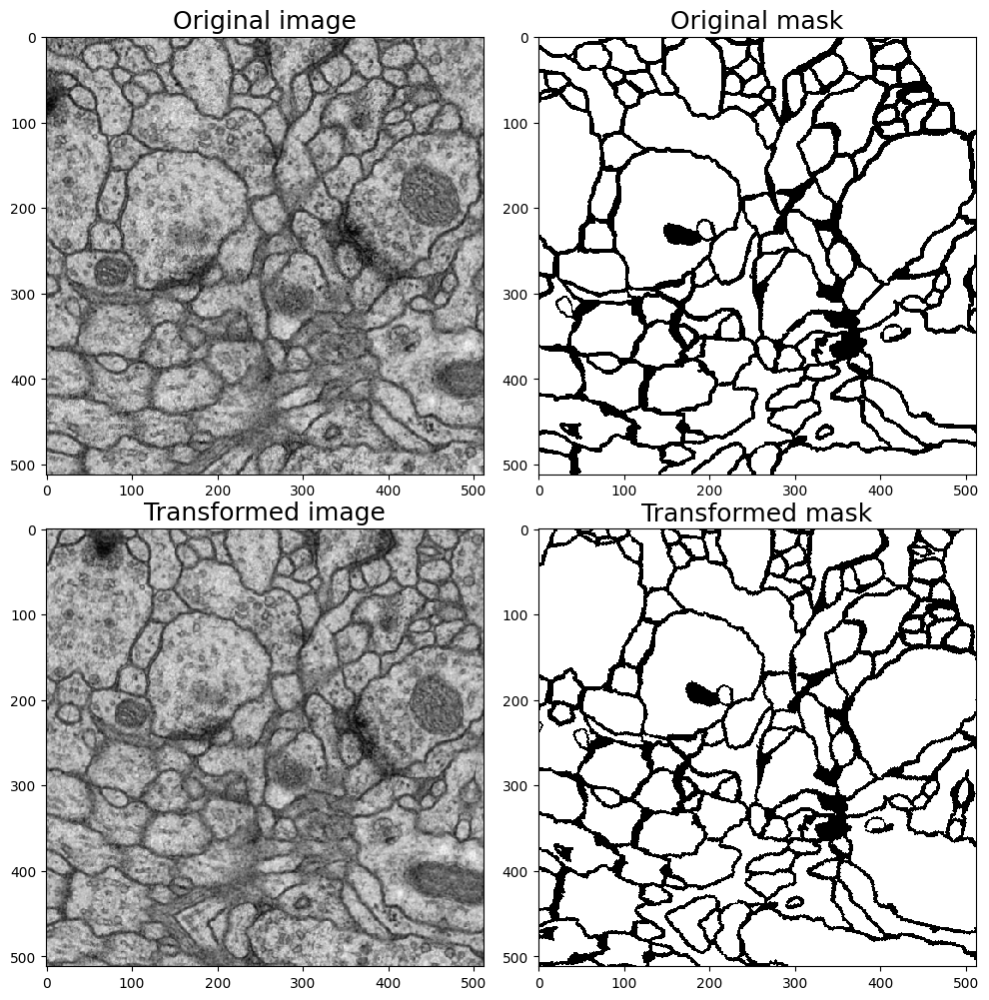

In [ ]:
transform = A.ShiftScaleRotate(p=1)
augmented = transform(image=img[0], mask=mask[0])
image_padded = augmented['image']
mask_padded = augmented['mask']
visualize(image_padded, mask_padded, original_image=img[0], original_mask=mask[0])

### GridDistortion

I could not find any good explanation for this technique but it is recommended for medical imaging. I found an image representing this technique in the official Albumentation paper(mentioned below).

From the image below I can only infer that

<img src="Images/transform&distort.png" alt="trainsert" width=50%/>

Albumentations: fast and flexible image augmentations : https://arxiv.org/pdf/1809.06839.pdf

Documentation : https://albumentations.ai/docs/api_reference/full_reference/?query=qwertyuiop%5B%5D%5CASDFGHJKL%3B%27#albumentations.augmentations.geometric.transforms.GridDistortion

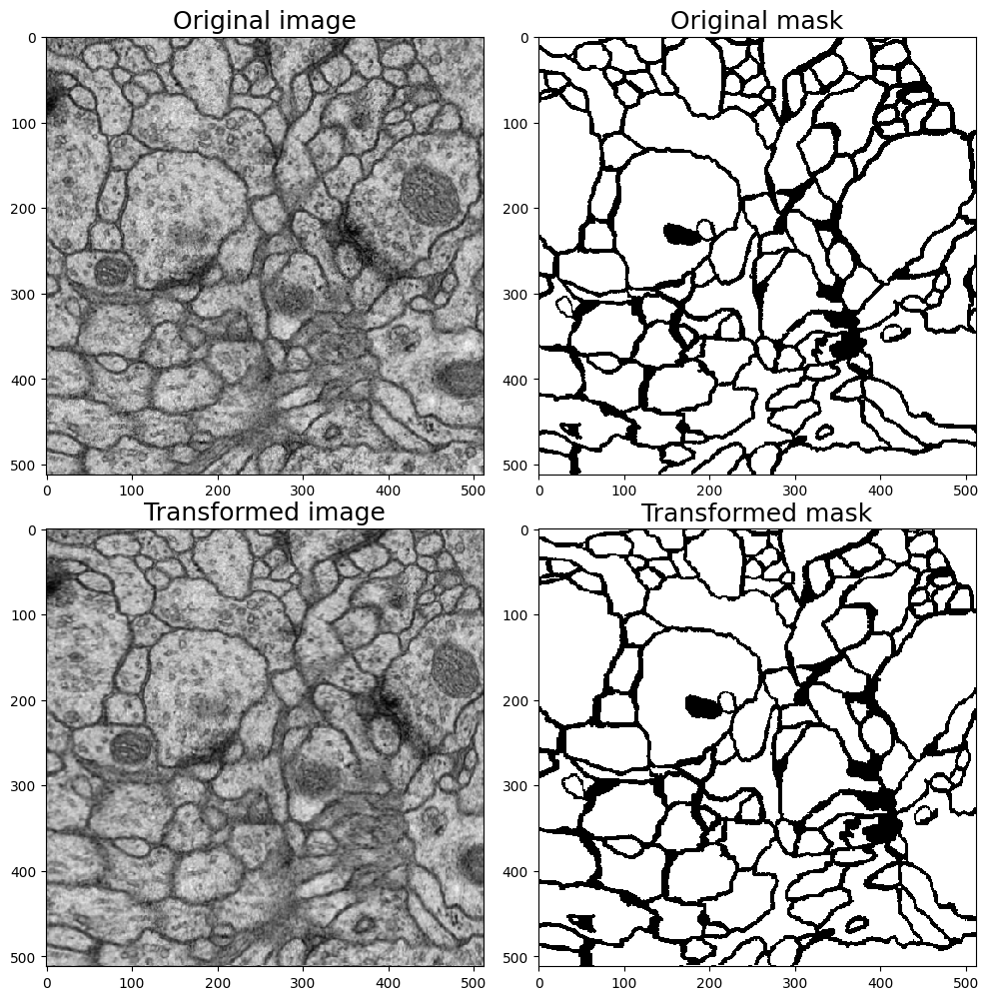

In [ ]:
transform = A.GridDistortion(p=1)
augmented = transform(image=img[0], mask=mask[0])
image_padded = augmented['image']
mask_padded = augmented['mask']
visualize(image_padded, mask_padded, original_image=img[0], original_mask=mask[0])

### OpticalDistortion

Can be explained in a nutshell as outward or inward expantion of images.

<img src="Images/opticaldistort.png" alt="trainsert" width=60%/>

Negative value to distort_limit and shift_limit give pincusion distortion and positive give barrel distortion

Documenation : https://albumentations.ai/docs/api_reference/full_reference/?query=qwertyuiop%5B%5D%5CASDFGHJKL%3B%27#albumentations.augmentations.geometric.transforms.OpticalDistortion

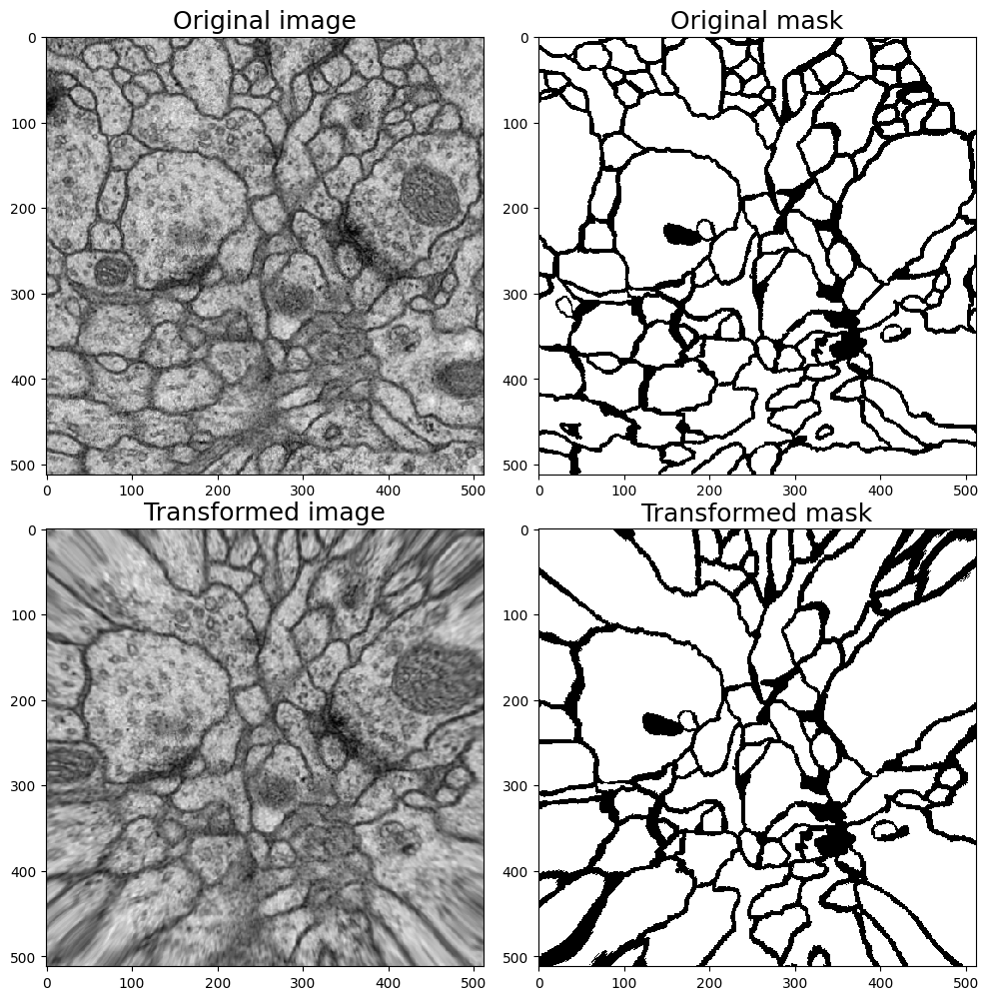

In [ ]:
transform = A.OpticalDistortion(distort_limit=-1.5 ,shift_limit=-20, p=1)
augmented = transform(image=img[0], mask=mask[0])
image_padded = augmented['image']
mask_padded = augmented['mask']
visualize(image_padded, mask_padded, original_image=img[0], original_mask=mask[0])

## Non-spatial stransformations

does not change the orentation of the image, only change the pixel values to augment the image. No chnages are made in the mask

### CLAHE

breaks the images into tiles and then evenly spreads out the contrast in that tile based on a histogram distribution. To aavoid amplification of low contrast area we cutoff the enhancement at some threshold.

Documentation : https://albumentations.ai/docs/api_reference/full_reference/?query=qwertyuiop%5B%5D%5CASDFGHJKL%3B%27#albumentations.augmentations.transforms.CLAHE

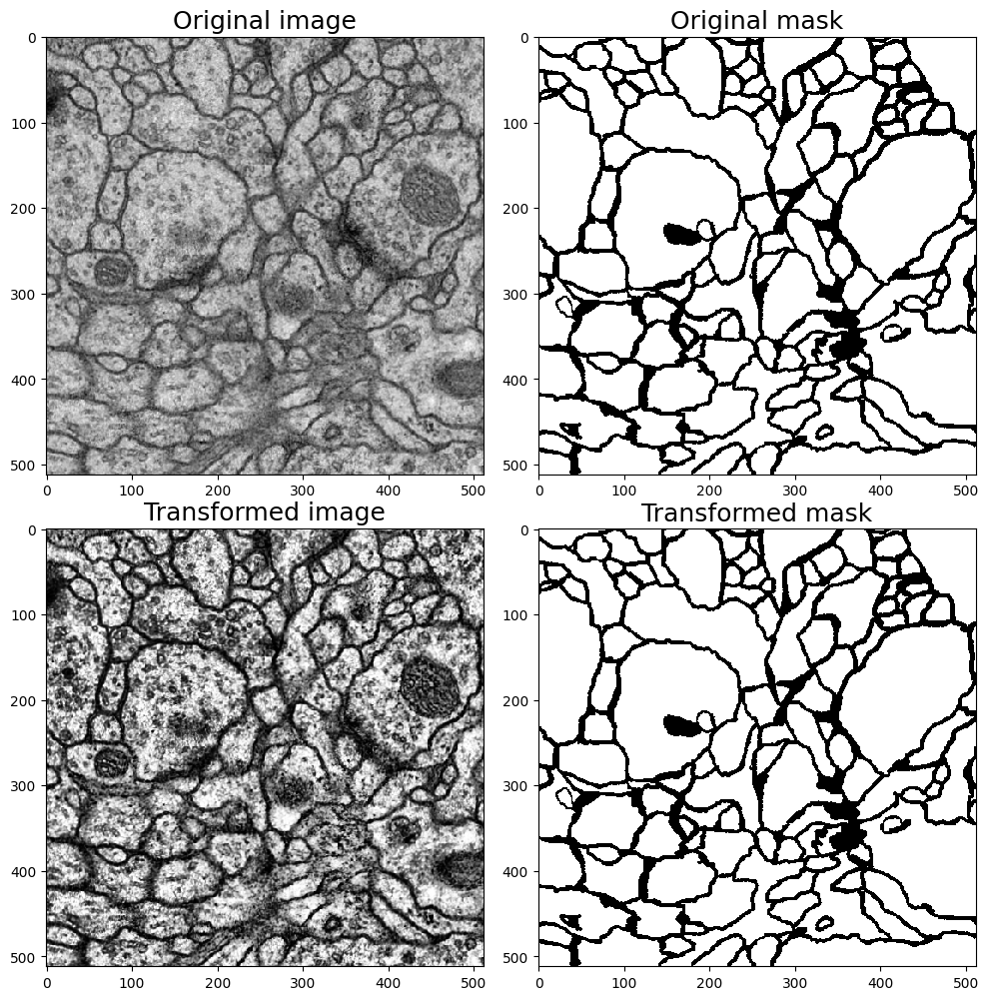

In [ ]:
transform = A.CLAHE(p=1)
augmented = transform(image=img[0], mask=mask[0])
image_padded = augmented['image']
mask_padded = augmented['mask']
visualize(image_padded, mask_padded, original_image=img[0], original_mask=mask[0])

### RandomBrightnessContrast

Randomly increases brightness and contrast.

Documenttions : https://albumentations.ai/docs/api_reference/full_reference/?query=qwertyuiop%5B%5D%5CASDFGHJKL%3B%27#albumentations.augmentations.transforms.RandomBrightnessContrast

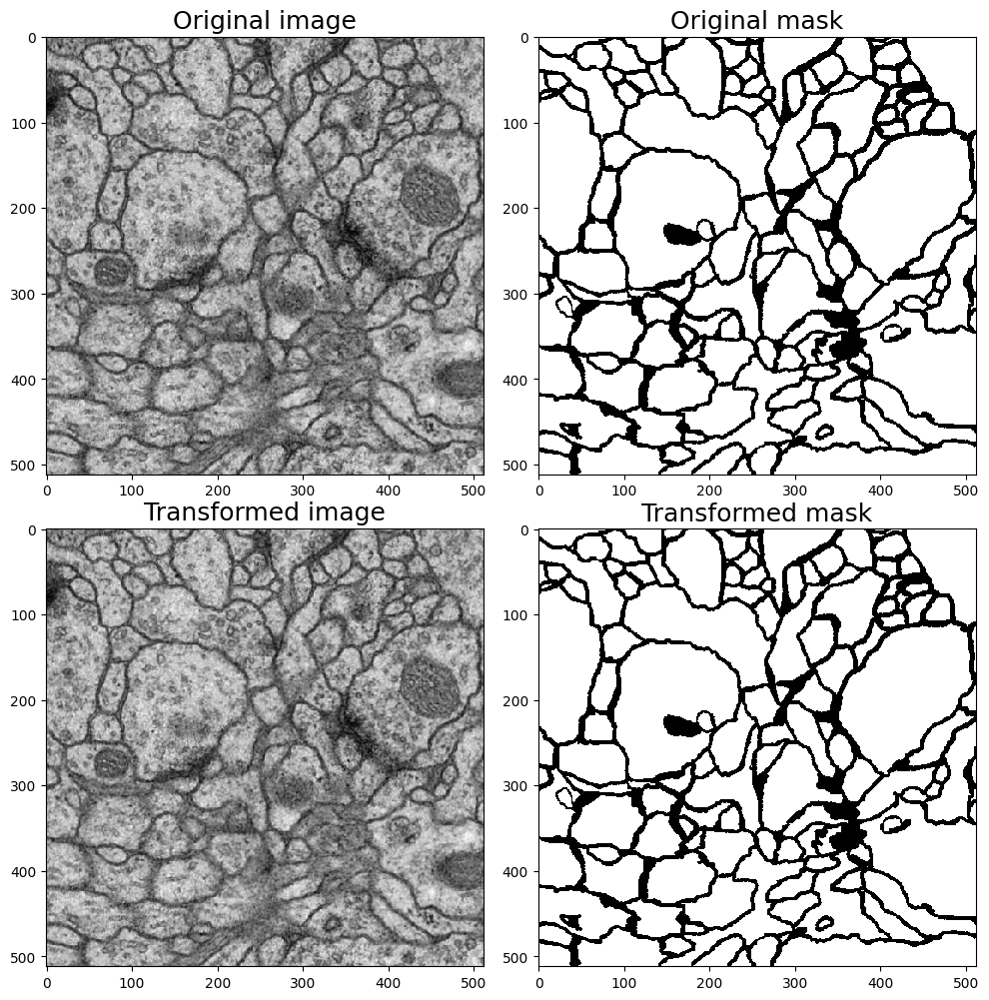

In [ ]:
transform = A.RandomBrightnessContrast(p=1)
augmented = transform(image=img[0], mask=mask[0])
image_padded = augmented['image']
mask_padded = augmented['mask']
visualize(image_padded, mask_padded, original_image=img[0], original_mask=mask[0])

### RandomFog

Simulates fog in the input image.

P.S. planned to implement earlier but dropped the idea as RandomFog only works on images with 3-channels(RGB)

Documenttions : https://albumentations.ai/docs/api_reference/full_reference/?query=qwertyuiop%5B%5D%5CASDFGHJKL%3B%27#albumentations.augmentations.transforms.RandomFog

In [ ]:
# transform = A.RandomFog(p=1)
# augmented = transform(image=img[0], mask=mask[0])
# image_padded = augmented['image']
# mask_padded = augmented['mask']
# visualize(image_padded, mask_padded, original_image=img[0], original_mask=mask[0])

### ColorJitter

Applies random brightness, contrast, and saturation to image

Documentation : https://albumentations.ai/docs/api_reference/full_reference/?query=qwertyuiop%5B%5D%5CASDFGHJKL%3B%27#albumentations.augmentations.transforms.ColorJitter

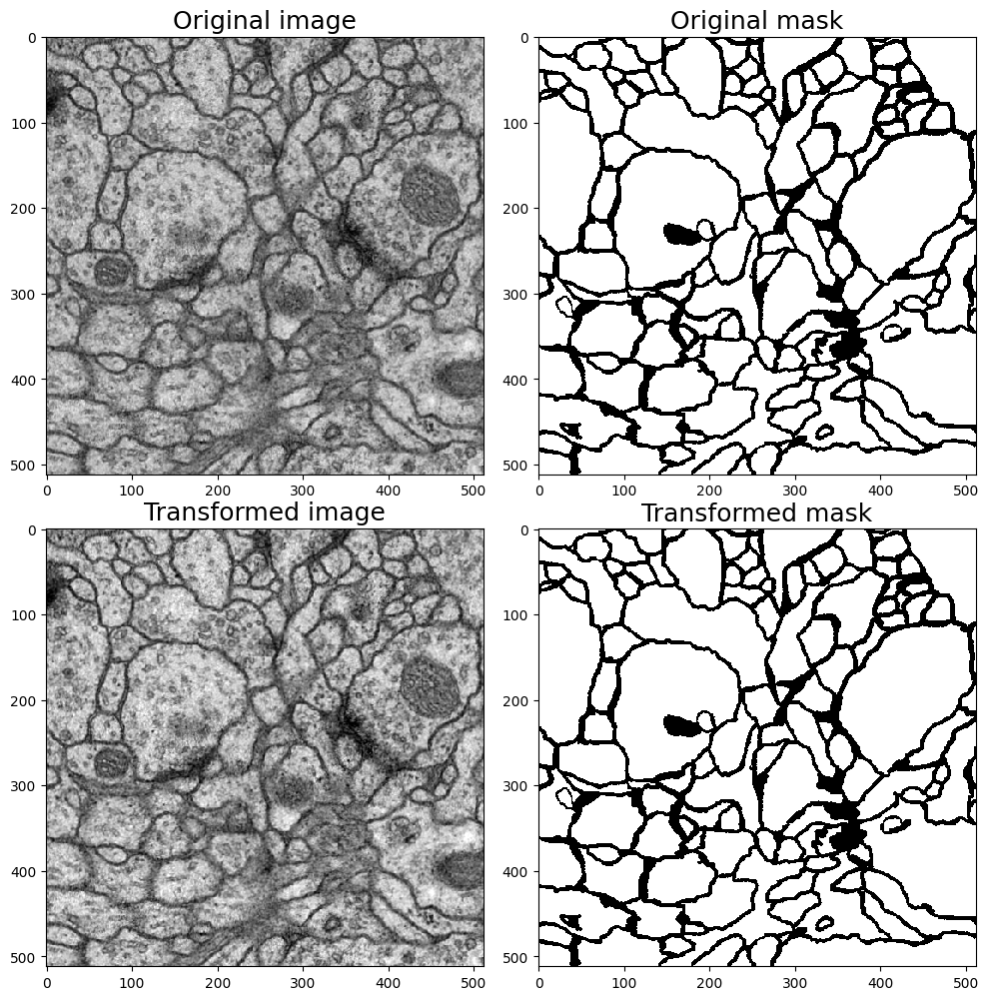

In [ ]:
transform = A.ColorJitter(p=1)
augmented = transform(image=img[0], mask=mask[0])
image_padded = augmented['image']
mask_padded = augmented['mask']
visualize(image_padded, mask_padded, original_image=img[0], original_mask=mask[0])

## Lets combine all the techniques to a single compose

Remember I mentioned the parameter 'p'. p refers to the probability of applying the transformation. P=1 mean the transformation is certainly applied and p=0 mean the transformation is certaily not applied. Any value of p between 0 and 1 gives us the value of how many times the transformation is being applied. p=0.9 says 90% of the time transformation is applied(obviously its an estimate).

In [ ]:
def randomvals():
    '''
    generates random values for elastic transformation and grid distort

    parameters
    -------------------
    None

    return
    -------------------
    alpha , sigma , distort_limit , shift_limit

    '''
    aplha = random.uniform(-1,1)
    sigma = random.uniform(-60,60)
    distort_limit = random.uniform(-5,5)
    shift_limit = random.uniform(-10,10)
    return alpha , sigma , distort_limit , shift_limit

In [ ]:
def show_images(images, cols = 1, titles = None):
    """Display a list of images in a single figure with matplotlib.

    Parameters
    ---------
    images: List of np.arrays compatible with plt.imshow.

    cols (Default = 1): Number of columns in figure (number of rows is
                        set to np.ceil(n_images/float(cols))).

    titles: List of titles corresponding to each image. Must have
            the same length as titles.
    """
    assert((titles is None)or (len(images) == len(titles)))
    n_images = len(images)
    if titles is None: titles = ['Image (%d)' % i for i in range(1,n_images + 1)]
    fig = plt.figure()
    for n, (image, title) in enumerate(zip(images, titles)):

        a = fig.add_subplot(cols, int(np.ceil(n_images/float(cols))), n + 1)
        if image.ndim == 2:
            plt.gray()
        imshow(image)
        a.set_title(title)
    fig.set_size_inches(np.array(fig.get_size_inches()) * n_images)
    plt.show()

In [ ]:
alpha , sigma , distort_limit , shift_limit = 1,1,1,1 #temporary
transform = A.Compose([
    A.HorizontalFlip(p=0.8),
    A.VerticalFlip(p=0.8),
    A.RandomRotate90(p=0.8),
    A.Transpose(p=0.5),
    A.OneOf([
        A.ShiftScaleRotate(p=0.25),
        A.ElasticTransform(alpha = alpha , sigma = sigma , p=0.6),
        A.GridDistortion(p=0.5),
        A.OpticalDistortion(distort_limit=distort_limit ,shift_limit=shift_limit, p=0.7),
    ] , p=1),
    A.OneOf([
        A.CLAHE(p=0.4),
        A.RandomBrightnessContrast(p=0.6),
        #A.RandomFog(0.4),
        A.ColorJitter(p=0.4),

    ],p=1),
    A.RandomResizedCrop(512,512 , p=0.7),


],p=1)

In [ ]:
'''
Basically Iterate a total 60 times over the data set and make random compositions of
transform to make new augmentation techniques.

'''

X_train = []
y_train = []
X_train.extend(img)
y_train.extend(mask)


for i in range(60):
    alpha , sigma , distort_limit , shift_limit = randomvals()
    for j in  range(len(img)):
        augmented = transform(image=img[j], mask=mask[j])
        image_ = augmented['image']
        mask_ = augmented['mask']
        X_train.append(image_ )
        y_train.append(mask_)


In [ ]:
'''
During this assignment I was stuck and my loss was going out of control, after serching for quite a while I quickly realized that this was because I did not normlize by images.
But that got me wondering .... why do we normalize , and the answer was way simpler than I though . Images non normalized can take values between 0 to 255 (say) Therefore when
computing gradient and cost during backprop the values like 255 initially will go out of control to a exponentially high value. To avoid this and also so the model does not prioratizee
255 over 0 we normalize our data.

'''
for i in range(len(X_train)):
    X_train[i] = X_train[i]/255
    y_train[i] = y_train[i]/255

In [ ]:
 #Spliting data to train and test to verify models accuracy later.
X_train, X_test,y_train, y_test = train_test_split(X_train,y_train,
                                   test_size=0.1,
                                   shuffle=True)

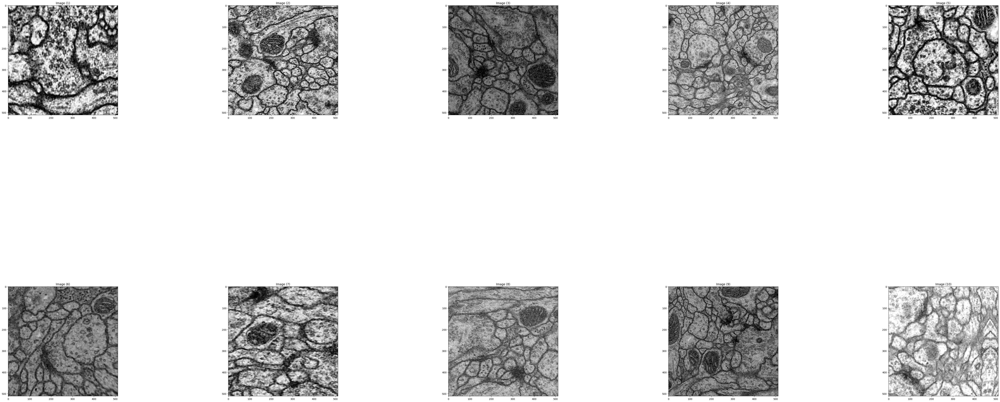

In [ ]:
show_images(X_train[65:75], cols = 2, titles = None)

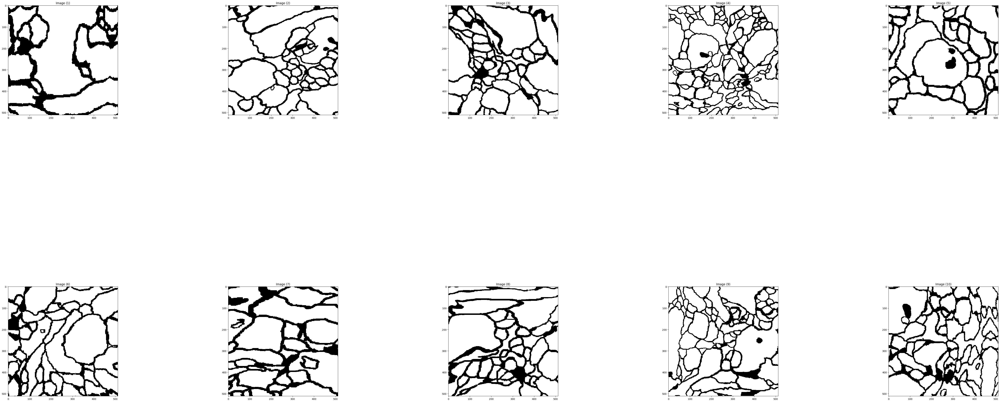

In [ ]:
show_images(y_train[65:75], cols = 2, titles = None)

# Model Application

## Unet

I will be implementing Unet for this biomedical image segmentation task. I am currently researching in this field and studying transformers to understand some of the recent architectures.


Unet are considered to be one of the most influential architectures in the realm of biomedical image segmentation. below is a detailed explanation of how I have learned this architecture.

<img src="Images/unet.png" alt="unet" width=50%/>

When I first read the problem statement it was quite obvious that this question is the same as what the unet paper tried to solve which was the isbi cell tracking challenge in 2015. Therefore for this unet becomes an obvious choice.

Unet follow a encoder-decoder architecture, encoder shrinks the image while the decoder enlarges it with the final total channels equal to the total classes to be classified, which in this case is 2(for binary classification). But then you have to ask yourself why do we use an encoder decoder architecture?

The compressed data at the bottom of the unet is reffered to as Latent Space which in simple terms is the representation of compressed data in which similar points are close to each other. It provides a means to represent data in a much more simpler form. This also forces the network to be able to learn and recognise the most important features as it is made to reconstruct the compressed data (decoder part).

Coming back to Unet, apart from the encder decoder architecture , Unets also have skip connection which contribute heavily to allowing low level features to travel all the way ahead in the architecture. This makes it easy for the network to retain important features even at the end of the network.

Downsampling is done basically using maxpooling but upsampling is done using transposed convolutions. This is particularly different from what segnet proposed , where it kept track of where each max pooled pixels was in the particular location and then place them in their respective positions duting up-pooling. In transposed convolution, the details of which have been mention in this article
https://towardsdatascience.com/what-is-transposed-convolutional-layer-40e5e6e31c11

Other than these changes, Overlap-tile strategy was used to use the GPU memory effeciently. In a nutshell,tiles were cutoff from the main image, only the center region of a tile was predicted (fom which full context was available) , The borders were padded by the correponding mirror images along the axis of the border providing context from the borders which previously lacked it.

Another problem was that the very thin border between touching cells was very difficult to duplicate in predictions. To get that part accurately segmented , authors applied weights to the regions that lacked pixels thus increaseing there importance during loss calculation. Loss calculations were done using crossentropy loss.

Below is the detailed model which is written from scratch. I will be explaning all of the major parts one by one.

1. Conv2D : Applies convolution operation to the input grid cell. Convolution operation is done using a kernel which in our case is a 3x3 matrix. These kernel act like feature extractors and output a feauremap highliting the features it has observed.
   
<img src="Images/conv.jpeg" alt="conv" width=30%/>

2. MaxPooling2D : Maxpooling helps to reduce the dimensions of the input whilst keeping the most important information (i.e. the most active pixel) intact in the output feature map.
   
<img src="Images/maxpool.png" alt="conv" width=30%/>

3. concatenate : the skip connection you see in the above image is nothing but concatenation of later feature map to the earlier one. cancatenation can we imagined as stacking one after the other sorta like we stack books in a shelfs!
   
4. Conv2DTranspose : This is an intresting idea to talk about. So I mentioned briefly before about transposed convolution, well  now lets take a deeper dive. Transposed convolution is the opposite of what convolution does, it upsamples the image unlike convolution which downsamples it.

The catch in transposed convolution is that the filter and the input are both applied to the output whose size and padded region as well as stride are already defined. The kerenl and the input slide over the output and the corresponding values are multiplied and assigned to the respective grid cell. But you might ask what about grid cells that overlapp as both the input and kernel travel across the output, well in that case we calculate the final value for each grid cell like before and then add to the existing value.

5. DropOut : It is a smart trick to avoid overfitting of data. We drop certain pixels(or neurons in case of neural nets) over the course of the training based on 1-keep_prob, this make the later layes less dependent on a particular pixel for featuer exteaction and thus making the overall network much more generalied. In a way it mimics the ensemble techniques we see in decision trees. Also an important thing to remember is that dropout is not applied during testing, all neurons are functional during testing.

<img src="Images/dropout.png" alt="conv" width=30%/>

One small concepts I dont want to miss explaning is kernel_initialization.

Kernel_initilization : A simple question that came to my mind doing a previous project was why just not initialize all value to 0. Quickly I realized (when I tried it on a neural network I made form scratch) is that this lead to very slow convergence to the minima and in some cases never , and the reason for that was vanishing gradient problem. Overtime the gradient became so small and insignificant that they hardly change the weeight or biases, contrary to that was exploding gradients where the gradient go so large that they overshot over the minima. One way to avoid this problem is to initialize the kernels(weights and biases) in a specific way. There are many ways like xavier or glorot uniform etc but for this specific task I choose he_normal as it tend to work better with ReLU activation function.

<img src="Images/he.png" alt="unet" width=50%/>



In [3]:




seed = 42
np.random.seed = seed

s = tf.keras.layers.Input((512, 512, 1))
c1 = tf.keras.layers.Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(s)
c1 = tf.keras.layers.Dropout(0.1)(c1)
c1 = tf.keras.layers.Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c1)
p1 = tf.keras.layers.MaxPooling2D((2, 2))(c1)

c2 = tf.keras.layers.Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p1)
c2 = tf.keras.layers.Dropout(0.1)(c2)
c2 = tf.keras.layers.Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c2)
p2 = tf.keras.layers.MaxPooling2D((2, 2))(c2)

c3 = tf.keras.layers.Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p2)
c3 = tf.keras.layers.Dropout(0.2)(c3)
c3 = tf.keras.layers.Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c3)
p3 = tf.keras.layers.MaxPooling2D((2, 2))(c3)

c4 = tf.keras.layers.Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p3)
c4 = tf.keras.layers.Dropout(0.2)(c4)
c4 = tf.keras.layers.Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c4)
p4 = tf.keras.layers.MaxPooling2D(pool_size=(2, 2))(c4)

c5 = tf.keras.layers.Conv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p4)
c5 = tf.keras.layers.Dropout(0.3)(c5)
c5 = tf.keras.layers.Conv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c5)

#Expansive path
u6 = tf.keras.layers.Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(c5)
u6 = tf.keras.layers.concatenate([u6, c4])
c6 = tf.keras.layers.Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u6)
c6 = tf.keras.layers.Dropout(0.2)(c6)
c6 = tf.keras.layers.Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c6)

u7 = tf.keras.layers.Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(c6)
u7 = tf.keras.layers.concatenate([u7, c3])
c7 = tf.keras.layers.Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u7)
c7 = tf.keras.layers.Dropout(0.2)(c7)
c7 = tf.keras.layers.Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c7)

u8 = tf.keras.layers.Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same')(c7)
u8 = tf.keras.layers.concatenate([u8, c2])
c8 = tf.keras.layers.Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u8)
c8 = tf.keras.layers.Dropout(0.1)(c8)
c8 = tf.keras.layers.Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c8)

u9 = tf.keras.layers.Conv2DTranspose(16, (2, 2), strides=(2, 2), padding='same')(c8)
u9 = tf.keras.layers.concatenate([u9, c1], axis=3)
c9 = tf.keras.layers.Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u9)
c9 = tf.keras.layers.Dropout(0.1)(c9)
c9 = tf.keras.layers.Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c9)

outputs = tf.keras.layers.Conv2D(1, (1, 1), activation='sigmoid')(c9)
model = tf.keras.Model(inputs=[s], outputs=[outputs])

In [ ]:

x = np.stack(X_train)

y = np.stack(y_train)


## Compile and Fit the model

There are a couple intresting concepts in the below code block which I will attempt to explain.

### Metrics

Accuracy : This is a straight forward one , It is the total classification the model got right divided by the total classifications

IoU : Standing for intersection over union , it is a method of evaluation the mask predicted by the model compared to the ground truth.

<img src="Images/iou.png" alt="conv" width=40%/>

In a nutshell IOU basically caluculates how much the models mask is overlaping with the ground truth label. The more the overlap the higher the IoU, which can be seen below.

<img src="./Images/iouexample.png" alt="conv" width=40%/>

source : https://towardsdatascience.com/intersection-over-union-iou-calculation-for-evaluating-an-image-segmentation-model-8b22e2e84686

### Adam

Adam is an optimization algorithm , its main goal to the reach the GLOBAL minima of the cost function as soon as possible. It achives so by two means 1) Gradient Descent with momentum and 2) RMSProp

As much as I would love to get into the detailed maths here I will avoid it so that I can efficiently cover other parts of the code as well without much compromise.

1) Gradient Descent with Momentum : The way I like to image it is using a bowl and a ball . The ball set loose at the top of the bowl would speed rooling down. This is the idea behind GDM. The momentum it gains from the slope it descents in the pursuit of the global minima helps it acquire momentum (due to weighed avg of the slopes it has come across, more weight is given to the past than to the present slope! sorry I cant help myself from getting into the maths). This allows GDM to swiftly more across local minimas.
2) RMSProp : In a nutshell allows the algo to move quicker in one direction(towards the minima) and slower in the perpendicular direction to the slope to minima.

Adam uses both to comupute its next step in the right direction towars the global minima.

### Loss Function - Mean Squared Error

<img src="./Images/mse.png" alt="conv" width=40%/>

MSE is a simple loss function, calculate the difference between predicted value and ground truth , square it , and then take mean of the entire batch. Calculating over an entire batch would give cost function which would be used to backprop through the algorithm to tweak the parameters.

* The Question arises : why did I use MSE over several other losses that solve class imbalance. Ans : I tried multiple losses namely : dice loss , focal loss , binary_crossentropy , categorical_crossentropy, even merged dice and focal to make a custom loss function but all ended up have lower IOU on validation data set compared to MSE.

### Batch Size

There are majorly 3 differnt gradient descent algorithms , batch GD - take the whole set of examples at once , mini-batch GD - take a small portion , Stocastic GD - take one at a time. I have obviously applies mini-batch as it is not as computationally intensive as batch while also not being very uncertain like SGD


In [ ]:
iou_score = tf.keras.metrics.BinaryIoU()
metrics=['accuracy', iou_score]

model.compile(optimizer='adam', loss='mean_squared_error', metrics=metrics)


model.summary()
results = model.fit(x, y, validation_split=0.1, batch_size=16, epochs=25)

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 512, 512, 1)]        0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, 512, 512, 16)         160       ['input_1[0][0]']             
                                                                                                  
 dropout (Dropout)           (None, 512, 512, 16)         0         ['conv2d[0][0]']              
                                                                                                  
 conv2d_1 (Conv2D)           (None, 512, 512, 16)         2320      ['dropout[0][0]']             
                                                                                              

In [ ]:
model.save('./model')

INFO:tensorflow:Assets written to: ./model/assets


INFO:tensorflow:Assets written to: ./model/assets


In [ ]:
model.save_weights('./weights/final_weights')

# Testing

Lets look at what our model has predicted.

In [ ]:
y_pred = model.predict(np.stack(X_test))

6/6 [==============================] - 11s 2s/step


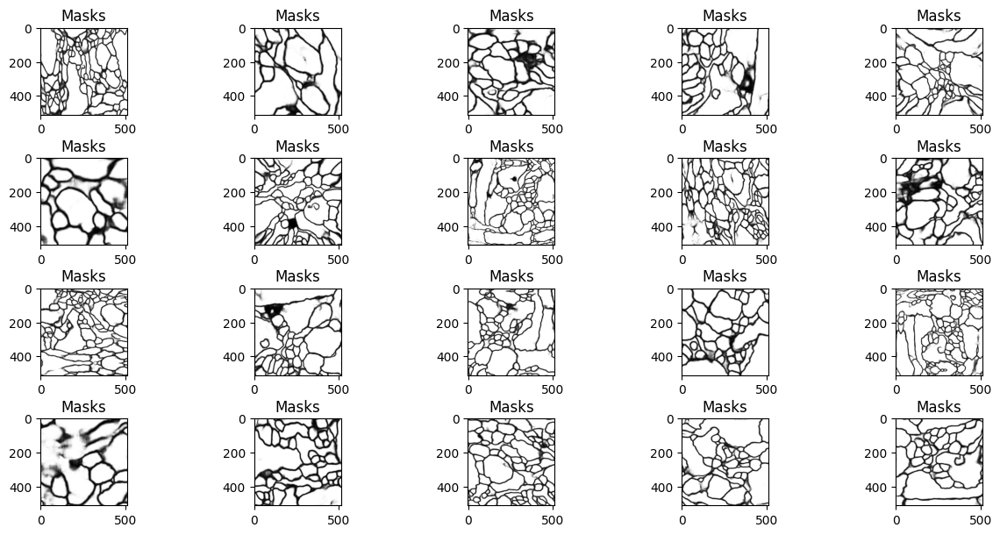

In [ ]:
plt.figure(figsize = (15 , 9))
n = 0
for i in range(20,40):
    n+=1
    plt.subplot(5 , 5, n)
    plt.subplots_adjust(hspace = 0.5 , wspace = 0.3)
    plt.imshow(y_pred[i] , cmap = 'gray')
    plt.title('Masks')

Text(0.5, 1.0, 'predicted')

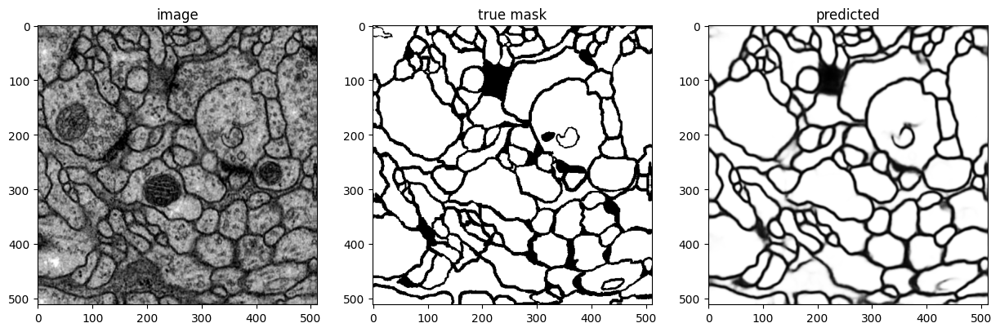

In [ ]:
#Lets look at some examples
plt.figure(figsize = (15 , 9))


plt.subplot(1, 3, 1)
plt.imshow(X_test[130] , cmap = 'gray')
plt.title('image')

plt.subplot(1, 3, 2)
plt.imshow(y_test[130] , cmap = 'gray')
plt.title('true mask')

plt.subplot(1, 3, 3)
plt.imshow(y_pred[130] , cmap = 'gray')
plt.title('predicted')

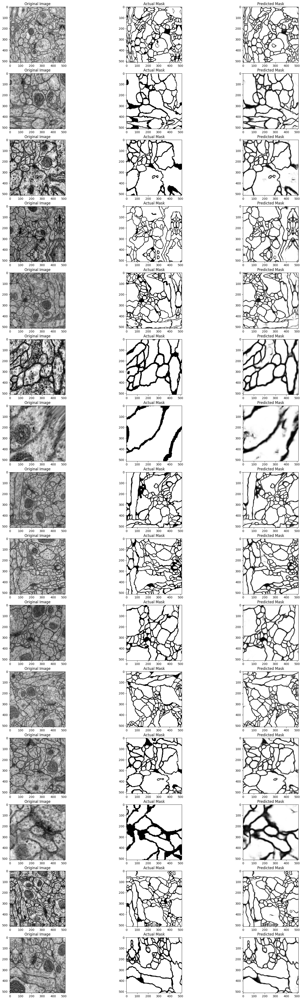

In [ ]:
f, axarr = plt.subplots(15,3,figsize=(20, 60))

for i in range(0,15):


    axarr[i,0].imshow(X_test[i], cmap = 'gray')
    axarr[i,0].title.set_text('Original Image')
    axarr[i,1].imshow(y_test[i], cmap = 'gray')
    axarr[i,1].title.set_text('Actual Mask')
    axarr[i,2].imshow(y_pred[i], cmap = 'gray')
    axarr[i,2].title.set_text('Predicted Mask')

In [ ]:
#to test the model run the libraries(2 cells) and model cell(1 cell) then run the below
model.load_weights('./saved_model/model')

2023-09-01 21:33:29.476471: W tensorflow/core/util/tensor_slice_reader.cc:97] Could not open ./saved_model/model: FAILED_PRECONDITION: saved_model/model; Is a directory: perhaps your file is in a different file format and you need to use a different restore operator?


In [ ]:
#Happy Testing :)